In [1]:
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras.applications import VGG16
from PIL import Image
import PIL
import PIL.Image



In [2]:
# Configure GPU settings
physical_devices = tf.config.experimental.list_physical_devices('GPU')
if physical_devices:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)

# Load all the images
train_dir = r"C:\Users\MMANTC-STL-08\Desktop\IND_Currency_Dataset"
TARGET_SIZE = 224
BATCH_SIZE = 64


In [3]:
# Data augmentation and loading
train_datagen = ImageDataGenerator(validation_split=0.2, rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    subset="training",
    shuffle=True,
    target_size=(TARGET_SIZE, TARGET_SIZE)
)

validation_generator = train_datagen.flow_from_directory(
    train_dir,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    subset="validation",
    shuffle=False,
    target_size=(TARGET_SIZE, TARGET_SIZE)
)

Found 1933 images belonging to 2 classes.
Found 483 images belonging to 2 classes.


In [4]:
# Print class indices
print(train_generator.class_indices)


{'fake': 0, 'real': 1}


In [5]:
# Using a VGG model for training
base_model = VGG16(weights='imagenet', input_shape=(TARGET_SIZE, TARGET_SIZE, 3), include_top=False)
base_model.trainable = False


In [6]:
# Adding a model on top
inputs = tf.keras.Input(shape=(TARGET_SIZE, TARGET_SIZE, 3))
x = base_model(inputs)
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dense(16, activation='relu')(x)
output = tf.keras.layers.Dense(len(train_generator.class_indices), activation='softmax')(x)

vgg = tf.keras.Model(inputs=inputs, outputs=output)
vgg.summary()


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ vgg16 (Functional)                   │ (None, 7, 7, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 512)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 16)                  │           8,208 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 2)                   │              34 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,722,930 (56.16 MB)

 Trainable params: 8,242 (32.20 KB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [7]:
# Compile the model
opt = tf.keras.optimizers.Adam()
cce = tf.keras.losses.CategoricalCrossentropy()
vgg.compile(optimizer=opt, loss=cce, metrics=['accuracy'])


In [8]:
# Define callbacks
checkpoint_filepath = 'model.weights.h5'
model_checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True
)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.001)

# Train the model
EPOCHS = 30
NUM_STEPS = train_generator.samples // BATCH_SIZE
VAL_NUM_STEPS = validation_generator.samples // BATCH_SIZE

# Fit the model and store the history
history = vgg.fit(
    train_generator,
    epochs=EPOCHS,
    steps_per_epoch=NUM_STEPS,
    validation_data=validation_generator,
    validation_steps=VAL_NUM_STEPS,
    callbacks=[reduce_lr, model_checkpoint_callback]
)


C:\Users\MMANTC-STL-08\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/30
30/30 ━━━━━━━━━━━━━━━━━━━━ 211s 7s/step - accuracy: 0.8607 - loss: 0.4307 - val_accuracy: 0.8683 - val_loss: 0.3652 - learning_rate: 0.0010
Epoch 2/30
 1/30 ━━━━━━━━━━━━━━━━━━━━ 41s 1s/step - accuracy: 0.9231 - loss: 0.2154

C:\Users\MMANTC-STL-08\AppData\Local\Programs\Python\Python310\lib\contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


30/30 ━━━━━━━━━━━━━━━━━━━━ 5s 140ms/step - accuracy: 0.9231 - loss: 0.2154 - val_accuracy: 1.0000 - val_loss: 0.0903 - learning_rate: 0.0010
Epoch 3/30
30/30 ━━━━━━━━━━━━━━━━━━━━ 250s 9s/step - accuracy: 0.8689 - loss: 0.3194 - val_accuracy: 0.8683 - val_loss: 0.2954 - learning_rate: 0.0010
Epoch 4/30
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 132ms/step - accuracy: 0.8594 - loss: 0.2589 - val_accuracy: 1.0000 - val_loss: 0.0650 - learning_rate: 0.0010
Epoch 5/30
30/30 ━━━━━━━━━━━━━━━━━━━━ 255s 9s/step - accuracy: 0.8969 - loss: 0.2418 - val_accuracy: 0.8862 - val_loss: 0.2574 - learning_rate: 0.0010
Epoch 6/30
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 147ms/step - accuracy: 0.8594 - loss: 0.3066 - val_accuracy: 1.0000 - val_loss: 0.0358 - learning_rate: 0.0010
Epoch 7/30
30/30 ━━━━━━━━━━━━━━━━━━━━ 254s 8s/step - accuracy: 0.9094 - loss: 0.2096 - val_accuracy: 0.9152 - val_loss: 0.2377 - learning_rate: 0.0010
Epoch 8/30
30/30 ━━━━━━━━━━━━━━━━━━━━ 11s 131ms/step - accuracy: 0.9531 - loss: 0.1979 - val_accurac

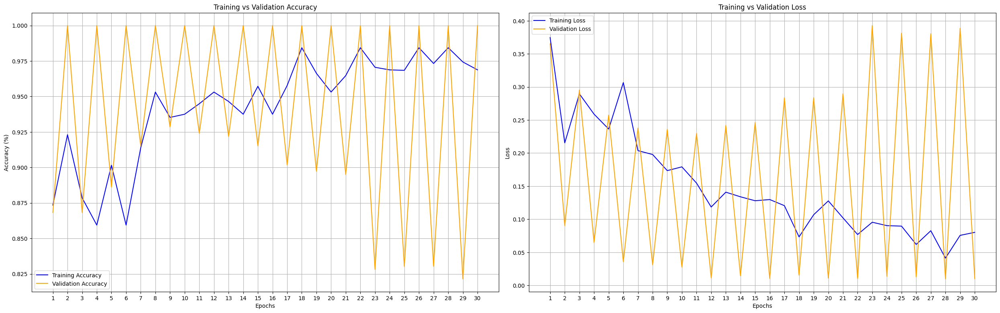

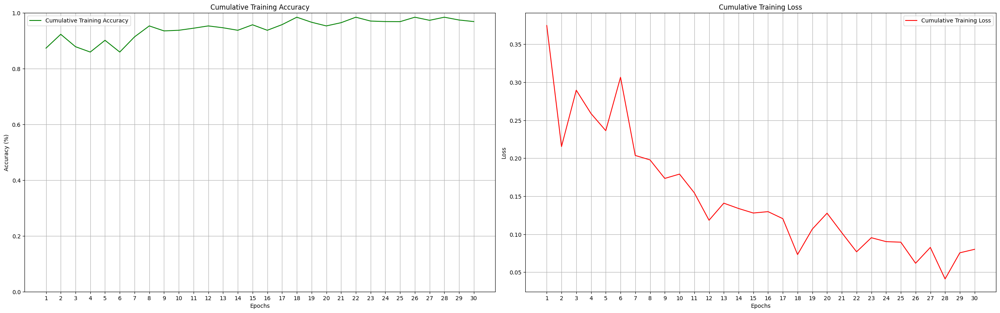

Final Model Loss: 0.0802
Final Model Accuracy: 0.9688


In [20]:


plt.figure(figsize=(25, 15)) 

# Plot 1: Training vs Validation Accuracy
plt.subplot(2, 2, 1)
plt.plot(history.history['accuracy'][:30], label='Training Accuracy', color='blue')  # Limit to 30 epochs
plt.plot(history.history['val_accuracy'][:30], label='Validation Accuracy', color='orange')  
plt.title('Training vs Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')  
plt.legend()
plt.grid()
plt.xticks(ticks=range(30), labels=range(1, 31))  

# Plot 2: Training vs Validation Loss
plt.subplot(2, 2, 2)
plt.plot(history.history['loss'][:30], label='Training Loss', color='blue')  # Limit to 30 epochs
plt.plot(history.history['val_loss'][:30], label='Validation Loss', color='orange')  # Limit to 30 epochs
plt.title('Training vs Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.xticks(ticks=range(30), labels=range(1, 31))  # Label epochs from 1 to 30

# Show the plots
plt.tight_layout()
plt.show()



plt.figure(figsize=(25, 15))  

# Plot 3: Cumulative Training Accuracy
plt.subplot(2, 2, 3)
plt.plot(history.history['accuracy'][:30], label='Cumulative Training Accuracy', color='green')  # Limit to 30 epochs
plt.title('Cumulative Training Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')  # Label 
plt.ylim(0, 1)  # Accuracy is between 0 and 1
plt.legend()
plt.grid()
plt.xticks(ticks=range(30), labels=range(1, 31))  # Set epoch labels from 1 to 30

# Plot 4: Cumulative Training Loss
plt.subplot(2, 2, 4)
plt.plot(history.history['loss'][:30], label='Cumulative Training Loss', color='red')  
plt.title('Cumulative Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.xticks(ticks=range(30), labels=range(1, 31))  # Set epoch labels from 1 to 30

# Adjust layout and show the plots
plt.tight_layout()
plt.show()



# Print final model loss and accuracy
final_loss = history.history['loss'][-1]
final_accuracy = history.history['accuracy'][-1]
print(f'Final Model Loss: {final_loss:.4f}')
print(f'Final Model Accuracy: {final_accuracy:.4f}')





In [23]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns


In [24]:
# Function to process images
def process_jpg_image(img):
    img = tf.convert_to_tensor(img[:, :, :3])
    img = np.expand_dims(img, axis=0)
    img = tf.image.resize(img, [224, 224])
    return img

# Function to test multiple images
def test_multiple_images(image_paths):
    predictions = []
    num_images = len(image_paths)

    # Calculate the number of rows and columns for subplots
    num_cols = 4
    num_rows = (num_images + num_cols - 1) // num_cols  # Ceiling division

    plt.figure(figsize=(15, num_rows * 5))  # Adjust height based on the number of rows

    for i, path in enumerate(image_paths):
        img = cv2.imread(path)
        if img is None:
            print(f"Error loading image: {path}")
            continue

        processed_img = process_jpg_image(img)
        pred = vgg.predict(processed_img)
        prediction = int(np.argmax(pred))
        predictions.append(prediction)

        # Display the image and prediction
        plt.subplot(num_rows, num_cols, i + 1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(f"Predicted: {class_names[prediction]}")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    return predictions  # Return predictions for further analysis


Class names: ['fake', 'real']
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━

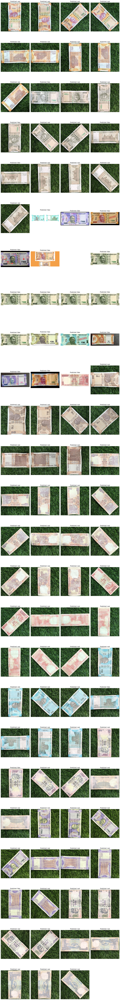

In [25]:
# Define class names
class_names = list(train_generator.class_indices.keys())
print("Class names:", class_names)

# Example usage with multiple image paths
test_image_paths = [
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA200_3.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA200_4.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA200_5.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA200_6.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA200_7.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA200_8.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA200_9.jpg" ,
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA200_10.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA200_11.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA500_1.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA500_2.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA500_3.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA500_4.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA500_5.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA500_6.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA500_7.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA500_8.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA500_9.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA500_10.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA500_11.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA500_12.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\New Rs 10_ Rs 50_ Rs 200 notes_ All y....jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\New Rs 100 Currency Note Is 100_ Make....jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\Reserve Bank of India - Homepage (1).png",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\Rs. 100 Banknote _ INDIA ....jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\Yellow Rs 200 Notes Are Here_ Use This....jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\कभी नोट में इस निशान पर किया है....jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\2f.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\3f.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\4f.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\5f.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\6f.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\7f.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\download (2).jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\download.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\images (1).jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\images (3).jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\images (6).jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\India_twenty_rupees_note.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10NEW_148.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10NEW_149.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10NEW_150.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10NEW_151.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10NEW_152.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10NEW_153.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10NEW_154.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10NEW_155.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10OLD_1.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10OLD_2.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10OLD_3.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10OLD_4.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10OLD_5.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10OLD_6.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10OLD_7.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10OLD_8.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10OLD_9.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10OLD_10.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10OLD_11.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA10OLD_12.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA20_5.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA20_6.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA20_7.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA20_8.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA20_9.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA20_10.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA20_11.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA20_12.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50NEW_3.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50NEW_4.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50NEW_5.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50NEW_6.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50NEW_7.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50NEW_8.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50NEW_9.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50NEW_10.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50OLD_3.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50OLD_4.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50OLD_5.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50OLD_6.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50OLD_7.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA50OLD_8.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100NEW_3.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100NEW_4.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100NEW_5.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100NEW_6.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100NEW_7.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100NEW_8.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100NEW_9.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100NEW_10.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100NEW_11.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100OLD_3.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100OLD_4.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100OLD_5.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100OLD_6.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100OLD_7.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100OLD_8.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100OLD_9.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100OLD_10.jpg",
          r"C:\Users\MMANTC-STL-08\Desktop\dataset\INDIA100OLD_11.jpg"
]

predictions = test_multiple_images(test_image_paths)

8/8 ━━━━━━━━━━━━━━━━━━━━ 25s 3s/step


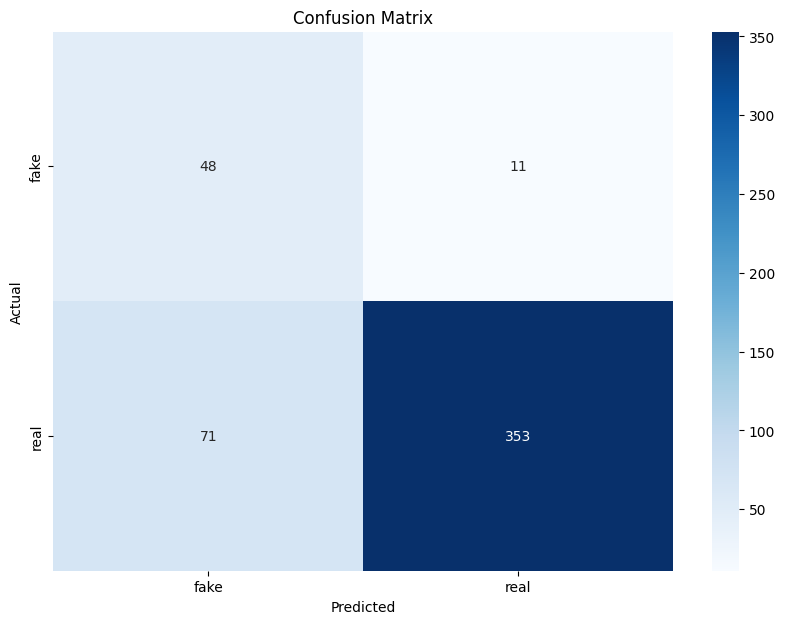

Accuracy: 0.8302
Precision: 0.9006
Recall: 0.8302
F1 Score: 0.8524


In [27]:
# Making predictions on the validation set and plotting confusion matrix
true_labels = validation_generator.classes
all_predictions = vgg.predict(validation_generator)

# Get predictions and calculate confusion matrix
preds = np.argmax(all_predictions, axis=1)
confusion_mat = confusion_matrix(true_labels, preds)

# Function to show confusion matrix
def show_confusion_matrix(confusion_mat, class_names):
    plt.figure(figsize=(10, 7))
    sns.heatmap(confusion_mat, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.ylabel('Actual')
    plt.xlabel('Predicted')
    plt.title('Confusion Matrix')
    plt.show()

show_confusion_matrix(confusion_mat, class_names)
# Calculate accuracy, precision, recall, and F1 score
report = classification_report(true_labels, preds, target_names=class_names, output_dict=True)
accuracy = np.sum(preds == true_labels) / len(true_labels)
precision = report['weighted avg']['precision']
recall = report['weighted avg']['recall']
f1 = report['weighted avg']['f1-score']

print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

